# Predict conversions for datascienceweekly website

Élaborer un modèle destiné à prédire le taux de conversion des clients sur un site web, en se basant sur diverses variables explicatives, et formuler des recommandations pour notre équipe marketing afin d'accroître nos revenus. Les performances des modèles seront évaluées à l'aide du F1-score.

## 1. Load data

In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer

from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay, PrecisionRecallDisplay, classification_report

# import base estimators
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC

# import ensemble methods
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, StackingClassifier
from xgboost import XGBClassifier

# import vizualization tools
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

In [2]:
# Nombre de processeurs à utiliser avec certains classifier
n_jobs = 3

In [3]:
raw_data = pd.read_csv('data/conversion_data_train.csv')
print('Set with labels (our train+test) :', raw_data.shape)

Set with labels (our train+test) : (284580, 6)


In [4]:
raw_data.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


### Variables du dataset:

- **country**: pays du visiteur
- **age**: age du visiteur
- **new_user**: le visiteur est-il nouveau ?
- **source**: comment est arrivé le visiteur
- **total_page_visited**: nombre de pages visitées
- **converted**: convertit en abonné ? --> variable cible

## 2. Data exploration

Statistiques basiques du dataset.

In [5]:
target_vc = raw_data['converted'].value_counts()
print(f"Déséquilibre de la variable cible dans l'ensemble des données : {round(100*(target_vc[1]/target_vc[0]), 2)}% de 1.")

Déséquilibre de la variable cible dans l'ensemble des données : 3.33% de 1.


In [6]:
# On ne garde qu'une partie du dataset et on met un random state pour garder la même portion,
# sinon les résultats ne seront pas les mêmes
# data_sample = raw_data.sample(50000, random_state=42)
data_sample = raw_data

target_vc2 = data_sample['converted'].value_counts()
print(f"Déséquilibre de la variable cible dans l'échantillon de données : {round(100*(target_vc2[1]/target_vc2[0]), 2)}% de 1.")

# Basic stats
print("Taille du dataset:")
print("Number of rows : {}".format(data_sample.shape[0]))
print("Number of columns : {}".format(data_sample.shape[1]))
print()
print("---------------------------")
print()

print("Dataset:")
print()
display(data_sample.head())
print()
print("---------------------------")

print("Basics infos:")
print()
display(data_sample.info())
print()
print("---------------------------")
print()

print("Basics statistics: ")
print()
data_desc = data_sample.describe(include='all')
display(data_desc)
print()
print("---------------------------")
print()

print("Unique elements by feature: ")
print()
display(data_sample.nunique().sort_values())
print()
print("---------------------------")
print()

print("Percentage of missing values: ")
print()
display(100*data_sample.isnull().sum()/data_sample.shape[0])

Déséquilibre de la variable cible dans l'échantillon de données : 3.33% de 1.
Taille du dataset:
Number of rows : 284580
Number of columns : 6

---------------------------

Dataset:



,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



---------------------------
Basics infos:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284580 entries, 0 to 284579
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   country              284580 non-null  object
 1   age                  284580 non-null  int64 
 2   new_user             284580 non-null  int64 
 3   source               284580 non-null  object
 4   total_pages_visited  284580 non-null  int64 
 5   converted            284580 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 13.0+ MB


None


---------------------------

Basics statistics: 



,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



---------------------------

Unique elements by feature: 



new_user                2
converted               2
source                  3
country                 4
total_pages_visited    29
age                    60
dtype: int64


---------------------------

Percentage of missing values: 



country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

**Observations**

Le modèle semble propre, pas de valeurs nulles ni de min et max incohérent.

## 3. Exploratory Data Analysis (EDA)

In [7]:
# Creation d'un nouveau dataset pour garder le raw_dataset intact
dataset = data_sample

### Visualisation des données

In [8]:
# Répartition des sources
sources_distribution_df = dataset['source'].value_counts().reset_index().rename(columns={"index": "source", 0: "count"})

fig = px.pie(sources_distribution_df, values='count', names='source', title='Sources distribution')
fig.show()

In [ ]:
# Répartition des visiteurs, nouveau ou non
new_users_distribution_df = dataset['new_user'].value_counts().reset_index().rename(columns={"index": "new_user", 0: "count"})

labels = {1:'yes', 0:'no'}
new_users_distribution_df['new_user'] = new_users_distribution_df['new_user'].map(labels)
fig = px.pie(new_users_distribution_df, values='count', names='new_user', title='New users distribution')
fig.show()

In [10]:
# Répartition des pays des utilisateurs
countries_distribution_df = dataset['country'].value_counts().reset_index().rename(columns={"index": "country", 0: "count"})

fig = px.pie(countries_distribution_df, values='count', names='country', title='Countries distribution')
fig.show()

In [11]:
# Répartition des conversions
converted_distribution_df = dataset['converted'].value_counts().reset_index().rename(columns={"index": "converted", 0: "count"})

labels = {1:'yes', 0:'no'}
converted_distribution_df['converted'] = converted_distribution_df['converted'].map(labels)
fig = px.pie(converted_distribution_df, values='count', names='converted', title='Converted users distribution')
fig.show()

In [12]:
# Répartition des ages (valeur numérique)
ages_distribution_df = dataset['age'].value_counts().reset_index().rename(columns={"index": "age", 0: "count"})

fig = px.bar(ages_distribution_df, x='age', y='count', title='Users age distribution')
fig.show()

In [13]:
# Répartition du nombre de pages visitées par utilisateur (valeur numérique)
ages_distribution_df = dataset['total_pages_visited'].value_counts().reset_index().rename(columns={"index": "total_pages_visited", 0: "count"})

fig = px.bar(ages_distribution_df, x='total_pages_visited', y='count', title='Total pages visited distribution')
fig.show()

In [14]:
# Visualisation de la distribution des données et repérage des outliers
fig = make_subplots(rows=1, cols=5, subplot_titles=("Country", "Age", "New user", "Source", "Total pages visited"))

fig.add_trace(go.Box(y=dataset['country'], name='Country'), row=1, col=1)
fig.add_trace(go.Box(y=dataset['age'], name='Age'), row=1, col=2)
fig.add_trace(go.Box(y=dataset['new_user'], name='New user'), row=1, col=3)
fig.add_trace(go.Box(y=dataset['source'], name='Source'), row=1, col=4)
fig.add_trace(go.Box(y=dataset['total_pages_visited'], name='Total pages visited'), row=1, col=5)

# Afficher la figure
fig.show()

**observations**

- La moitié des visiteurs viennent du SEO.
- Les visiteur convertit représent seulement 3.28%
- Environ 69% des visiteurs sont nouveaux.

### Qui sont les utilisateurs convertis ?

In [15]:
# Nombre de conversions par âge
age_conversions = dataset.groupby('age')['converted'].sum().reset_index()
fig = px.bar(age_conversions, x='age', y='converted', color='converted',
  barmode='overlay',
  title='Nombre de conversions par âge',
  labels={'age': 'Age', 'converted': 'Conversion'},
  color_continuous_scale=px.colors.sequential.Viridis
)

# Afficher le graphique
fig.show()

In [16]:
converted_df = dataset[dataset['converted'] == 1][['new_user', 'converted']]
converted_df

,new_user,converted
2,0,1
12,1,1
42,0,1
127,1,1
200,0,1
...,...,...
284434,0,1
284464,0,1
284486,0,1
284563,1,1


In [ ]:
# Nombre de conversions par type d'utilisateur
new_user_conversions = converted_df.groupby('new_user')['converted'].sum().reset_index()
fig = px.bar(new_user_conversions, x='new_user', y='converted', color='converted',
  barmode='overlay',
  title='Nombre de conversions par type d\'utilisateur',
  labels={'new_user': 'Nouvel utilisateur', 'converted': 'Conversion'},
  color_continuous_scale=px.colors.sequential.Viridis
)

# Afficher le graphique
fig.show()

In [ ]:
# Nombre de conversions par provenance (SEO)
source_conversions = dataset.groupby('source')['converted'].sum().reset_index()
fig = px.bar(source_conversions, x='source', y='converted', color='converted',
  barmode='overlay',
  title='Nombre de conversions par type de source',
  labels={'source': 'Source', 'converted': 'Conversion'},
  color_continuous_scale=px.colors.sequential.Viridis
)

# Afficher le graphique
fig.show()

In [19]:
fig = px.histogram(dataset, x="source", color="converted", barmode="group")
fig.show()

In [20]:
# Nombre de conversions par rapport aux nombre de page visitées
pages_conversions = dataset.groupby('total_pages_visited')['converted'].mean().reset_index()
fig = px.bar(pages_conversions, x='total_pages_visited', y='converted', color='total_pages_visited',
  barmode='overlay',
  title='Nombre de conversions par rapport aux nombres de pages visitées',
  labels={'total_pages_visited': 'Nombres de pages visitées', 'converted': 'Conversion'},
  color_continuous_scale=px.colors.sequential.Viridis
)

# Afficher le graphique
fig.show()

In [21]:
fig = px.histogram(dataset, 
                   x="total_pages_visited", 
                   color="converted", 
                   barmode="group",
                   labels={'total_pages_visited': 'Nombres de pages visitées', 'converted': 'Conversion'},
                   title='Nombre de conversions par rapport aux nombres de pages visitées',
                  )
fig.show()

In [22]:
fig = px.line(pages_conversions, 
              x="total_pages_visited", 
              y="converted", 
              markers=True,
              labels={'total_pages_visited': 'Nombres de pages visitées', 'converted': 'Conversion'},
              title='Nombre de conversions par rapport aux nombres de pages visitées',
             )
fig.show()

**Observations**

- Les utilisateurs s'inscrivant sont plutôt jeunes, en dessous de 30 ans.
- Ce sont plutôt des utilisateurs qui sont déjà venus sur le site.
- Ce sont principalementdes utilisateurs venant des publicités ou du SEO.
- Plus un visiteur visite des pages, plus il a de chance de s'inscrire, cette variable semble assez importante.

### Corrélations

In [23]:
# Correlation matrix
corr_matrix = dataset.corr(numeric_only=True).round(2)
fig = ff.create_annotated_heatmap(corr_matrix.values,
    x = corr_matrix.columns.tolist(),
    y = corr_matrix.index.tolist(),
    colorscale='Viridis',
    showscale=True,
    zmin=-1,
    zmax=1,
)
fig.update_layout(
    width=800,
    height=600,
    margin=dict(t=50, r=50, l=50, b=50) 
)
                                  
fig.show()

**Observations**

@todo: afficher aussi l importance des variables

La matrice de corrélation nous confirme que la valeur la plus utile et la variable **total_pages_visited**.

Il y a peu de corrélation entre les autres variables.

## 4. Training

### 1. Baseline model

**D'après l'analyse exploratoire des données (EDA), nous savons que la caractéristique la plus utile est le nombre total de pages visitées. Créons un modèle de base en utilisant d'abord uniquement cette caractéristique : dans les prochaines cellules, nous effectuerons des prétraitements et entraînerons une régression logistique simple (univariée).**

Bien penser à mettre le stratify=y dans le train_test_split car les valeurs de la variable cible sont très disproportionnées.

In [24]:
features_list = ['total_pages_visited']
numeric_indices = [0]
categorical_indices = []
target_variable = 'converted'

# Variable to save all score_save
score_save = {}

In [25]:
X = dataset.loc[:, features_list]
Y = dataset.loc[:, target_variable]

print('Explanatory variables : ', X.columns)
print()

Explanatory variables :  Index(['total_pages_visited'], dtype='object')



In [26]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42, stratify=Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [27]:
pd.DataFrame(Y).value_counts()

converted
0            275400
1              9180
Name: count, dtype: int64

#### Training pipeline

In [28]:
# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")

featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.56068654]
 [ 1.5340925 ]
 [-1.15919483]
 [-0.56068654]
 [-1.15919483]]


In [29]:
# Train model
print("Train model...")
basemodel = LogisticRegression()
basemodel.fit(X_train, y_train)
print("...Done.")

Train model...
...Done.


In [30]:
# Predictions on training set
print("Predictions on training set...")
y_train_pred = basemodel.predict(X_train)
print("...Done.")
print(y_train_pred)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]



#### Test pipeline

In [31]:
# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")

X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.85994069]
 [-0.56068654]
 [-0.56068654]
 [ 0.03782176]
 [-0.26143239]]


In [32]:
# Predictions on test set
print("Predictions on test set...")
y_test_pred = basemodel.predict(X_test)
print("...Done.")
print(y_test_pred)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]



#### Performance assessment on baseline model

In [33]:
# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)


tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['basemodel'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}


print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.82      0.60      0.69      6426

    accuracy                           0.98    199206
   macro avg       0.90      0.80      0.84    199206
weighted avg       0.98      0.98      0.98    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.83      0.61      0.70      2754

    accuracy                           0.98     85374
   macro avg       0.91      0.80      0.85     85374
weighted avg       0.98      0.98      0.98     85374



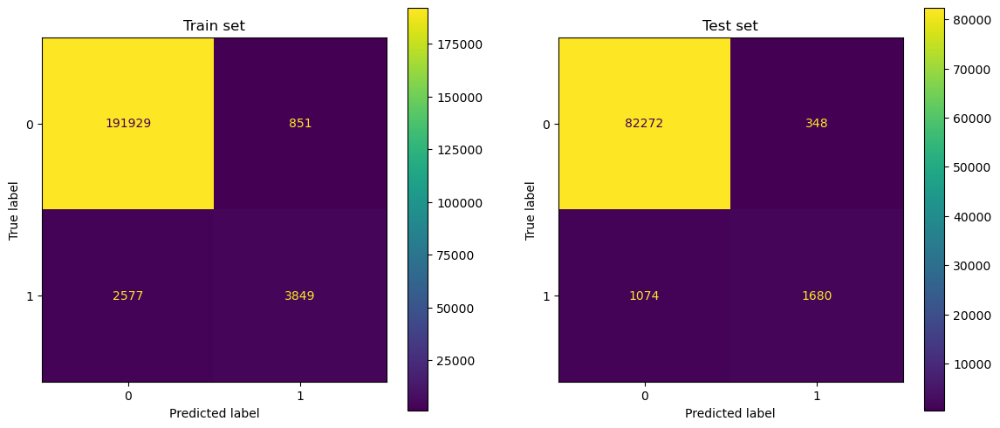

In [34]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(basemodel, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(basemodel, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

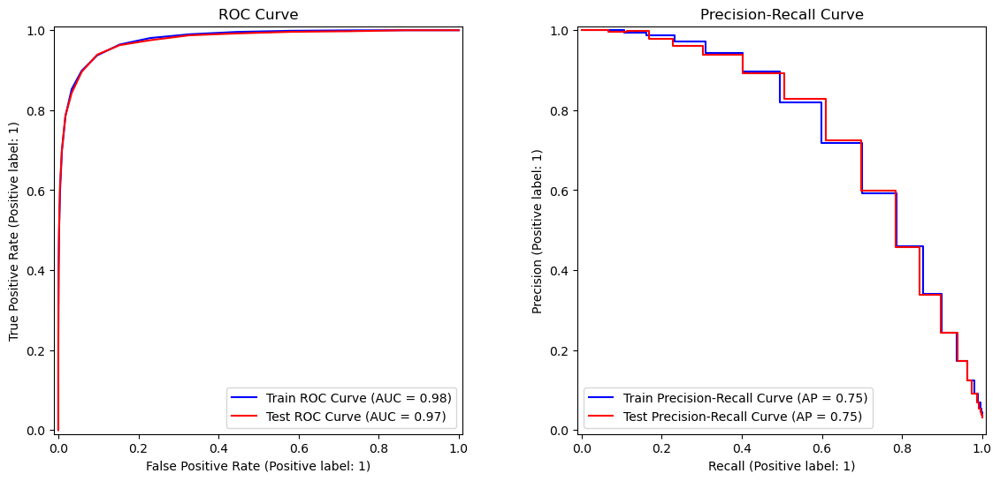

In [35]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    basemodel, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    basemodel, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    basemodel, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    basemodel, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

**Observations**

- Le modèle de base atteint un score f1 de plus de 70%.
- Le modèle de base se trompe à environ 60% sur les valeurs positives, les valeurs négatives étant  bien préditent (moins de 1% d'erreur).


**Rappel**

- Courbe ROC : La courbe ROC trace le taux de vrais positifs (TPR ou rappel) contre le taux de faux positifs (FPR) pour différents seuils de classification. Le taux de faux positifs est défini comme le ratio des faux positifs sur le nombre total de négatifs.
- Courbe Precision-Recall : Dans le cas de classes déséquilibrées, la courbe precision-recall (précision-rappel) est souvent plus informative. Elle trace la précision (le pourcentage de prédictions positives correctes) contre le rappel (le pourcentage de vrais positifs capturés) pour différents seuils.

### 2. Régression logistique multivariées

Maintenant que nous avons un modèle de référence, nous allons pouvoir comparer les performances de plusieurs modèle. Nous allons commencer par un autre modèle de regression logistique en utilisant cette fois-ci l'ensemble des features. 

#### Preprocessing

In [ ]:
# Calcul du class weights, utililes car les données sont unbalanced
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weights = {0: class_weights[0], 1: class_weights[1]}
print("class weights for Y:")
print(class_weights)

class weights for Y:
{0: 0.5166666666666667, 1: 15.5}


In [37]:
features_list = ['total_pages_visited', 'age', 'new_user', 'country', 'source']
numeric_features = ['total_pages_visited', 'age']
categorical_features = ['new_user', 'country', 'source']
target_variable = 'converted'

print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(drop='first')

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),                    
        ('cat', categorical_transformer, categorical_features)
    ])

Encoding categorical features and standardizing numerical features...


In [38]:
X = dataset.loc[:, features_list]
Y = dataset.loc[:, target_variable]

print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42, stratify=Y)
print("...Done.")
print()

X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

print("Check ratio on y_test and y_train")
unique, counts = np.unique(y_train, return_counts=True)
print('Value count y_train')
print(np.asarray((unique, counts)).T)
print("...Done")
print()

unique, counts = np.unique(y_test, return_counts=True)
print('Value count y_test')
print(np.asarray((unique, counts)).T)

print("...Done")
print(X_train[0:5,:])
print(X_test[0:5,:])
print("--------------------------")

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Check ratio on y_test and y_train
Value count y_train
[[     0 192780]
 [     1   6426]]
...Done

Value count y_test
[[    0 82620]
 [    1  2754]]
...Done
[[-0.56068654 -0.06905373  0.          0.          0.          1.
   0.          0.        ]
 [ 1.5340925   1.86294015  0.          1.          0.          0.
   0.          1.        ]
 [-1.15919483  0.65544398  1.          0.          0.          1.
   1.          0.        ]
 [-0.56068654  1.25919206  0.          0.          0.          1.
   1.          0.        ]
 [-1.15919483 -0.79355144  1.          0.          0.          0.
   1.          0.        ]]
[[-0.85994069  0.17244551  1.          0.          0.          1.
   0.          1.        ]
 [-0.56068654  1.74219054  1.          0.          0.          0.
   0.          0.        ]
 [-0.56068654  0.77619359  0.   

#### Training

In [39]:
# Train model
print("Train model...")
reglogmul_model = LogisticRegression()
reglogmul_model.fit(X_train, y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
y_train_pred = reglogmul_model.predict(X_train)
print("...Done.")
print(y_train_pred)
print()

# Predictions on test set
print("Predictions on test set...")
y_test_pred = reglogmul_model.predict(X_test)
print("...Done.")
print(y_test_pred)
print()

Train model...
...Done.
Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]



In [40]:
# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

score_save['reglogmul_model'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

Écart type des résidus sur y_train : 0.11736948631981244
Écart type des résidus sur y_test : 0.11674123377762129
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.85      0.69      0.76      6426

    accuracy                           0.99    199206
   macro avg       0.92      0.84      0.88    199206
weighted avg       0.99      0.99      0.99    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.86      0.69      0.76      2754

    accuracy                           0.99     85374
   macro avg       0.92      0.84      0.88     85374
weighted avg       0.99      0.99      0.99     85374



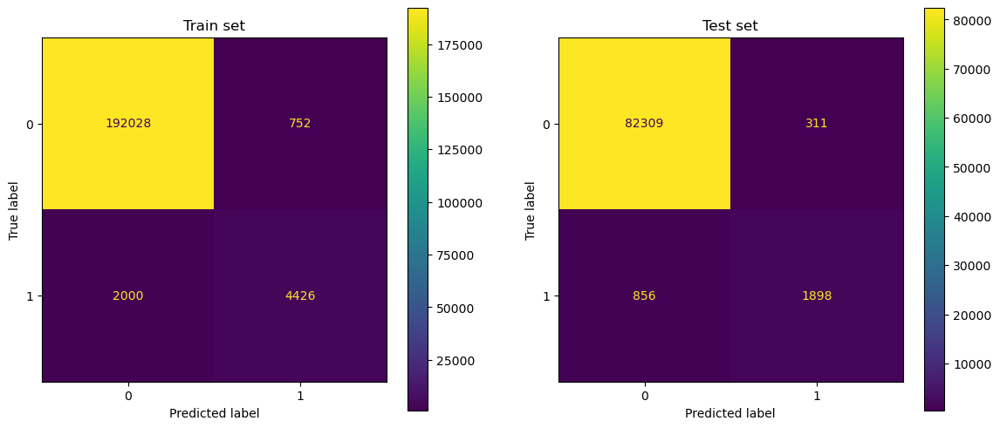

In [41]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(reglogmul_model, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(reglogmul_model, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

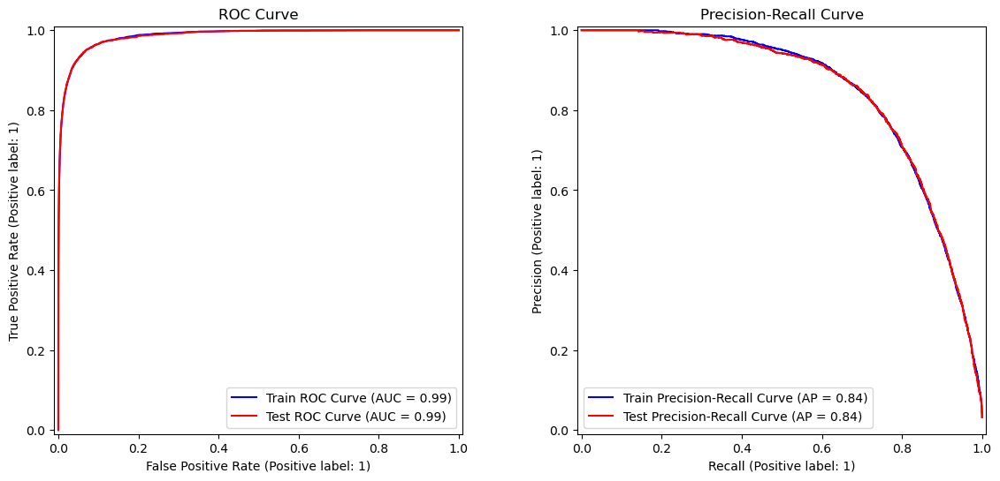

In [42]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    reglogmul_model, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    reglogmul_model, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    reglogmul_model, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    reglogmul_model, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

**Observations**

- En prenant en compte plus de données le score f1 s'est amélioré et la précision aussi. 
---

### 3. Decision Tree with gridsearch

In [43]:
tree_clf = DecisionTreeClassifier()
params = {
    "max_depth": [5, 10, 15, 20, 30, 40, 50],
    "min_samples_split": [2, 4, 6, 8, 10],
    "class_weight": ['balanced', None]
}

gridsearch_tree = GridSearchCV(tree_clf, param_grid=params, n_jobs=n_jobs, cv=5, scoring='f1') 
gridsearch_tree.fit(X_train, y_train)
print("Best: %f using %s" % (gridsearch_tree.best_score_, gridsearch_tree.best_params_))

# Visualisation des hyperparamètres les plus importants
gs_scores_df = pd.DataFrame(gridsearch_tree.cv_results_).iloc[:10, [6, 13, 14]]. \
    sort_values(by='mean_test_score', axis=0, ascending=False)
display(gs_scores_df)

y_train_pred = gridsearch_tree.predict(X_train)
y_test_pred = gridsearch_tree.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['tree_clf'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}


print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

Best: 0.741591 using {'class_weight': None, 'max_depth': 5, 'min_samples_split': 2}


,param_min_samples_split,mean_test_score,std_test_score
6,4,0.482397,0.004279
5,2,0.482304,0.004315
8,8,0.482235,0.004217
7,6,0.482185,0.004211
9,10,0.482022,0.003992
0,2,0.464011,0.011989
1,4,0.464011,0.011989
2,6,0.464011,0.011989
3,8,0.464011,0.011989
4,10,0.464011,0.011989


Écart type des résidus sur y_train : 0.12176087756836365
Écart type des résidus sur y_test : 0.12144025945348617
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.84      0.66      0.74      6426

    accuracy                           0.99    199206
   macro avg       0.92      0.83      0.87    199206
weighted avg       0.98      0.99      0.98    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.84      0.67      0.74      2754

    accuracy                           0.99     85374
   macro avg       0.92      0.83      0.87     85374
weighted avg       0.98      0.99      0.98     85374

Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1    

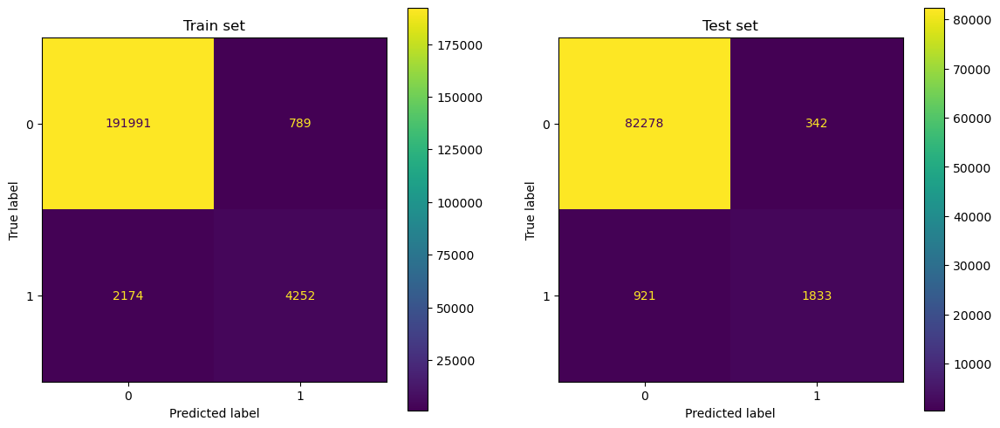

In [44]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_tree, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_tree, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

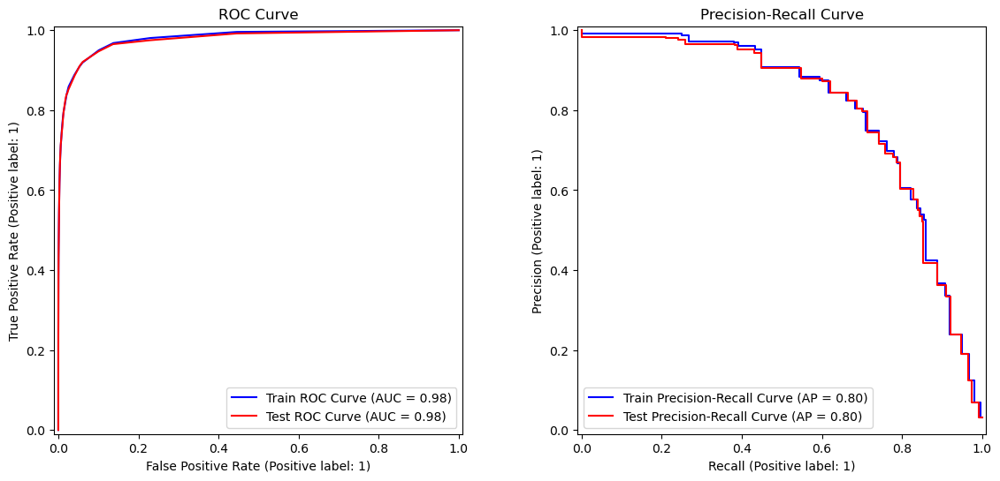

In [45]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_tree, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_tree, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_tree, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_tree, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

**Observations**

On voit bien avec la precision recall curve les difficulté du modèle pour la prédictions des valeurs à 1.

### 4. Random Forest with gridsearch

In [46]:
forest_clf = RandomForestClassifier()

params = {
    'max_depth': [10, 15, 20, 25, 30], # Cette hyperparamètre contrôle la profondeur maximale des arbres dans la forêt. Des valeurs faibles peuvent réduire le surajustement, mais si elles sont trop faibles, elles peuvent sous-ajuster les données.
    'min_samples_split': [2, 4, 8, 16, 24], # Ce paramètre contrôle le nombre minimum d'échantillons requis pour diviser un noeud interne.
    'n_estimators': [50, 100, 150], # C'est le nombre d'arbres dans la forêt. Plus il y a d'arbres, plus la performance du modèle est stable, mais cela augmente aussi le temps de calcul.
}

gridsearch_rf = GridSearchCV(forest_clf, param_grid=params, n_jobs=n_jobs, cv=5, scoring='f1') 
gridsearch_rf.fit(X_train, y_train)
print("Best: %f using %s" % (gridsearch_rf.best_score_, gridsearch_rf.best_params_))

y_train_pred = gridsearch_rf.predict(X_train)
y_test_pred = gridsearch_rf.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['forest_clf'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

/home/alexandre/miniforge3/envs/tf-gpu-env/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning:

invalid value encountered in cast



Best: 0.755429 using {'max_depth': 15, 'min_samples_split': 24, 'n_estimators': 50}
Écart type des résidus sur y_train : 0.11337058434038957
Écart type des résidus sur y_test : 0.11993298437475951
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.87      0.71      0.78      6426

    accuracy                           0.99    199206
   macro avg       0.93      0.85      0.89    199206
weighted avg       0.99      0.99      0.99    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.84      0.68      0.75      2754

    accuracy                           0.99     85374
   macro avg       0.91      0.84      0.87     85374
weighted avg       0.98      0.99      0.98     85374



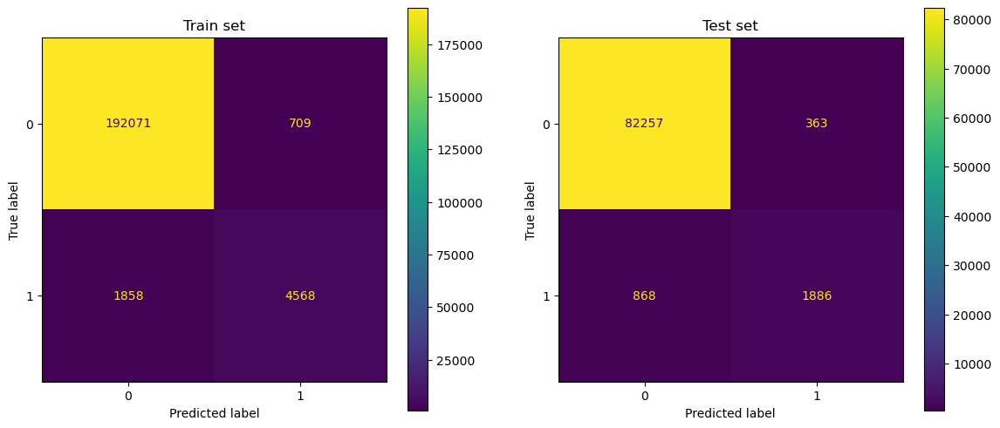

In [47]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_rf, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_rf, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

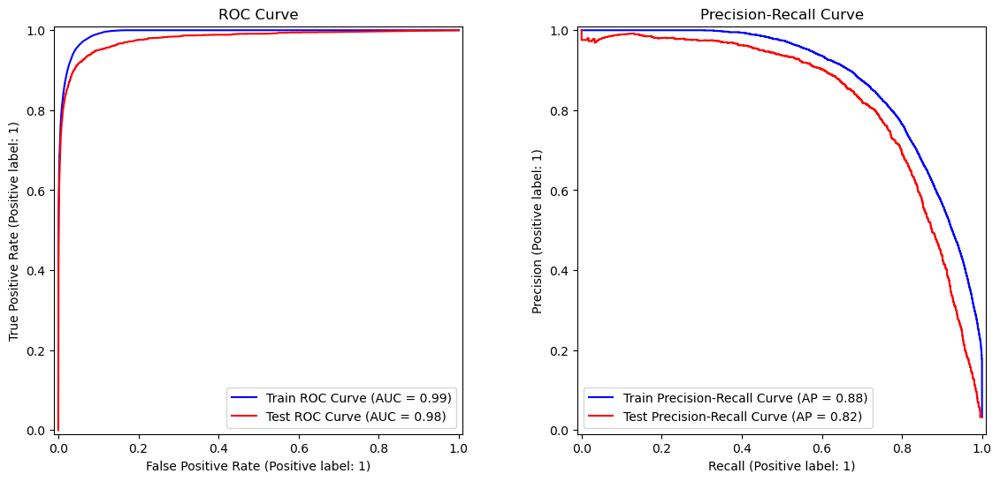

In [48]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_rf, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_rf, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_rf, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_rf, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

### 5. Adaboost with gridsearch

In [49]:
ada_cls = AdaBoostClassifier(estimator=reglogmul_model, algorithm='SAMME')

# Grid of values to be tested
params = {
  "estimator__C": [
        0.5,
        1,
        5,
        10
    ],  # base_estimator__ prefix because C is a parameter from LogisticRegression!
    'n_estimators' : [5, 10, 25, 50, 70, 90],
    'learning_rate' : [0.001, 0.01, 0.1, 1, 10]
}

gridsearch_ada = GridSearchCV(ada_cls, param_grid=params, n_jobs=n_jobs, cv=5, scoring='f1')

gridsearch_ada.fit(X_train, y_train)
print("Best: %f using %s" % (gridsearch_ada.best_score_, gridsearch_ada.best_params_))

y_train_pred = gridsearch_ada.predict(X_train)
y_test_pred = gridsearch_ada.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['ada_cls'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

Best: 0.741852 using {'estimator__C': 5, 'learning_rate': 0.1, 'n_estimators': 50}
Écart type des résidus sur y_train : 0.12857067281823376
Écart type des résidus sur y_test : 0.12782494310549833
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99    192780
           1       0.75      0.74      0.74      6426

    accuracy                           0.98    199206
   macro avg       0.87      0.86      0.87    199206
weighted avg       0.98      0.98      0.98    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     82620
           1       0.75      0.73      0.74      2754

    accuracy                           0.98     85374
   macro avg       0.87      0.86      0.87     85374
weighted avg       0.98      0.98      0.98     85374



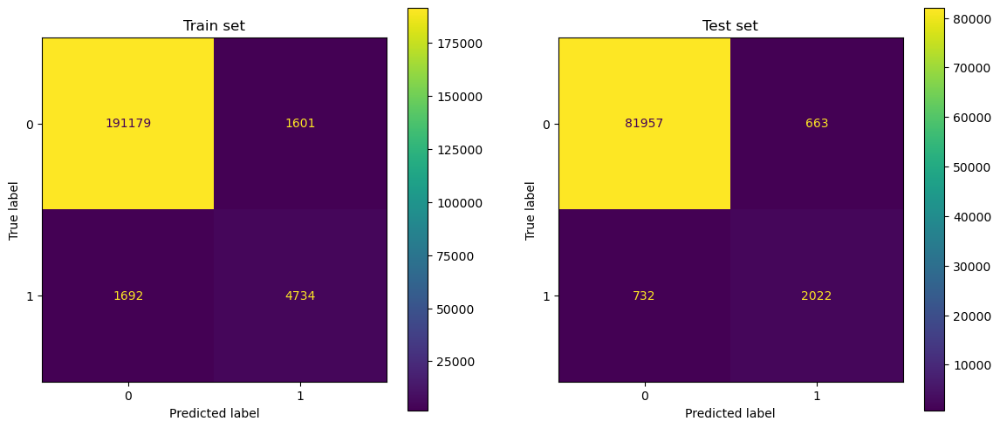

In [50]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_ada, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_ada, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

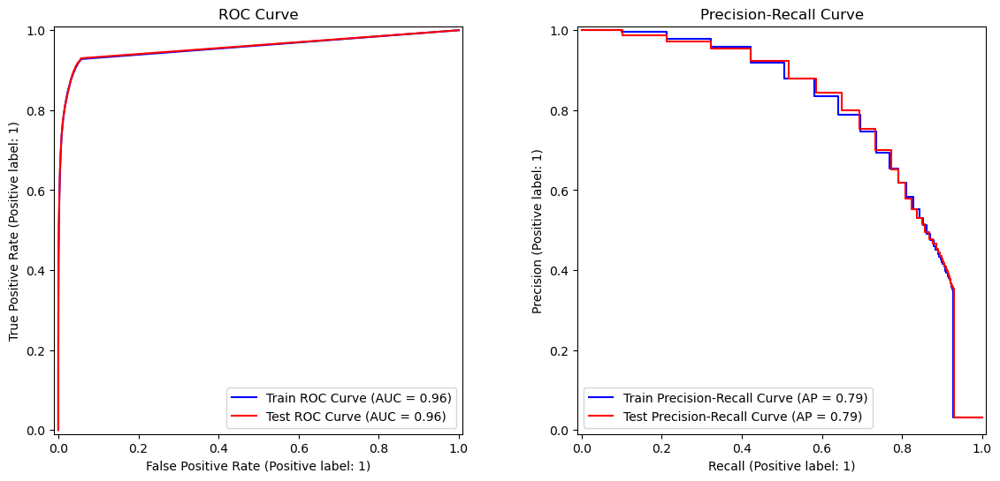

In [51]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_ada, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_ada, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_ada, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_ada, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

### 6. XGBoost with gridsearch

In [52]:
xgb_cls = XGBClassifier()
# xgb_cls = XGBClassifier(device="cuda")

# Grid of values to be tested
params = {
    "max_depth": [2, 4, 6, 8],  # exactly the same role as in scikit-learn
    "min_child_weight": [
        0.5, 
        2,
        10, 
        20, 
        50,
        75,
    ],  # effect is more or less similar to min_samples_leaf and min_samples_split
    "n_estimators": [
        20,
        30,
        40,
        75,
    ],  # exactly the same role as in scikit-learn
}

gridsearch_xgb = GridSearchCV(xgb_cls, param_grid=params, n_jobs=n_jobs, cv=5, scoring='f1')

gridsearch_xgb.fit(X_train, y_train)
print("Best: %f using %s" % (gridsearch_xgb.best_score_, gridsearch_xgb.best_params_))

y_train_pred = gridsearch_xgb.predict(X_train)
y_test_pred = gridsearch_xgb.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['xgb_cls'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

/home/alexandre/miniforge3/envs/tf-gpu-env/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning:

invalid value encountered in cast



Best: 0.765210 using {'max_depth': 4, 'min_child_weight': 75, 'n_estimators': 40}
Écart type des résidus sur y_train : 0.11713018856534455
Écart type des résidus sur y_test : 0.11724078363264842
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.85      0.70      0.77      6426

    accuracy                           0.99    199206
   macro avg       0.92      0.85      0.88    199206
weighted avg       0.99      0.99      0.99    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.84      0.70      0.77      2754

    accuracy                           0.99     85374
   macro avg       0.92      0.85      0.88     85374
weighted avg       0.99      0.99      0.99     85374



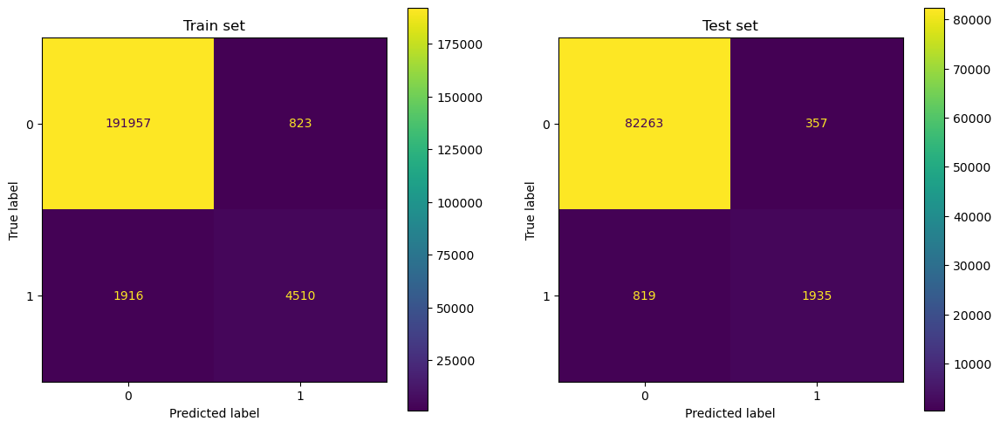

In [53]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_xgb, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_xgb, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

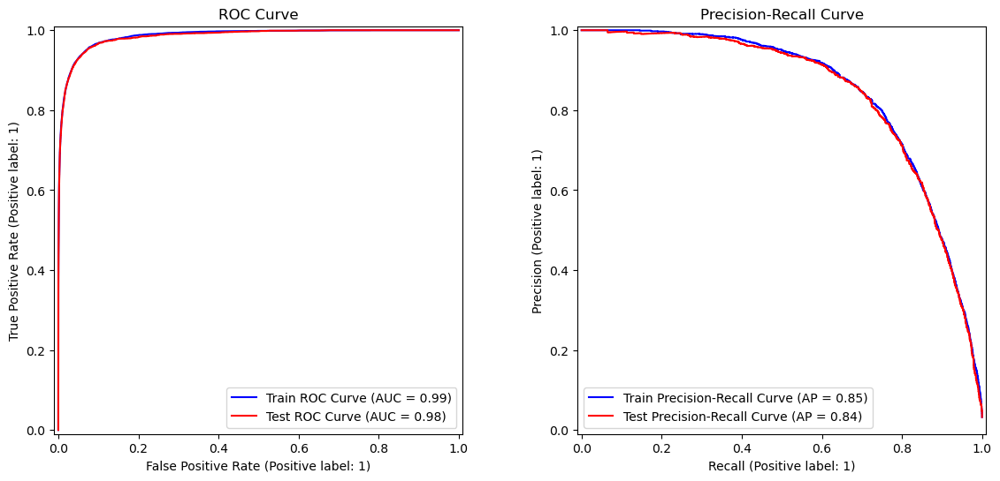

In [54]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_xgb, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_xgb, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_xgb, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_xgb, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

### 7. SVM with gridsearch

In [55]:
# SVM
# Perform grid search
print("Grid search...")
svm_cls = SVC()
# @todo mettre classe (class_weight="balanced")

# Grid of values to be tested
params = {
    'kernel': (['linear']),
    'C': [0.1, 1, 10, 100, 1000],
    'gamma': [0.01, 0.1, 1, 10, 100],
}
gridsearch_svm = GridSearchCV(svm_cls, param_grid=params, n_jobs=n_jobs, cv=3, scoring='f1')

gridsearch_svm.fit(X_train, y_train)
print("Best: %f using %s" % (gridsearch_svm.best_score_, gridsearch_svm.best_params_))

y_train_pred = gridsearch_svm.predict(X_train)
y_test_pred = gridsearch_svm.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['svm_cls'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

Grid search...


/home/alexandre/miniforge3/envs/tf-gpu-env/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



Best: 0.760872 using {'C': 1, 'gamma': 0.01, 'kernel': 'linear'}
Écart type des résidus sur y_train : 0.1174833659605567
Écart type des résidus sur y_test : 0.11794650870184764
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.86      0.68      0.76      6426

    accuracy                           0.99    199206
   macro avg       0.93      0.84      0.88    199206
weighted avg       0.99      0.99      0.99    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.86      0.67      0.76      2754

    accuracy                           0.99     85374
   macro avg       0.93      0.83      0.87     85374
weighted avg       0.99      0.99      0.99     85374



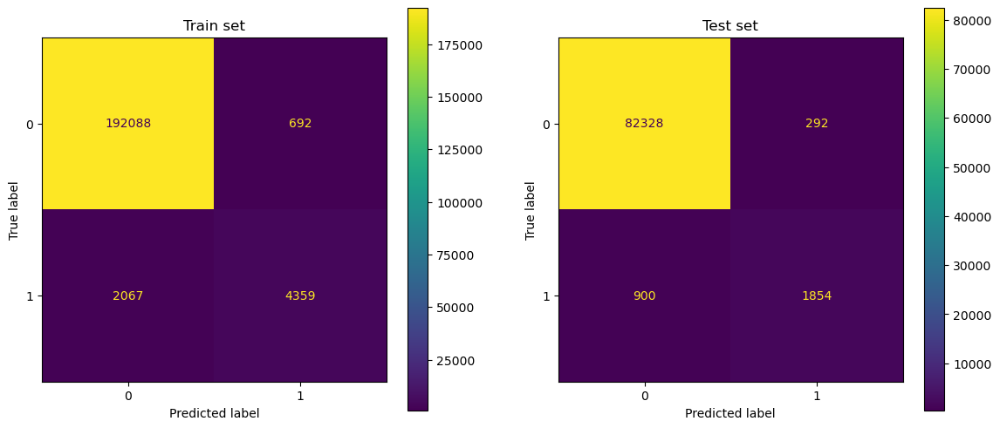

In [56]:
# Visualize confusion matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

ax1.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_svm, X_train, y_train, ax=ax1) # ConfusionMatrixDisplay from sklearn
ax1.set_title('Train set')

ax2.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch_svm, X_test, y_test, ax=ax2) # ConfusionMatrixDisplay from sklearn
ax2.set_title('Test set')

plt.show()

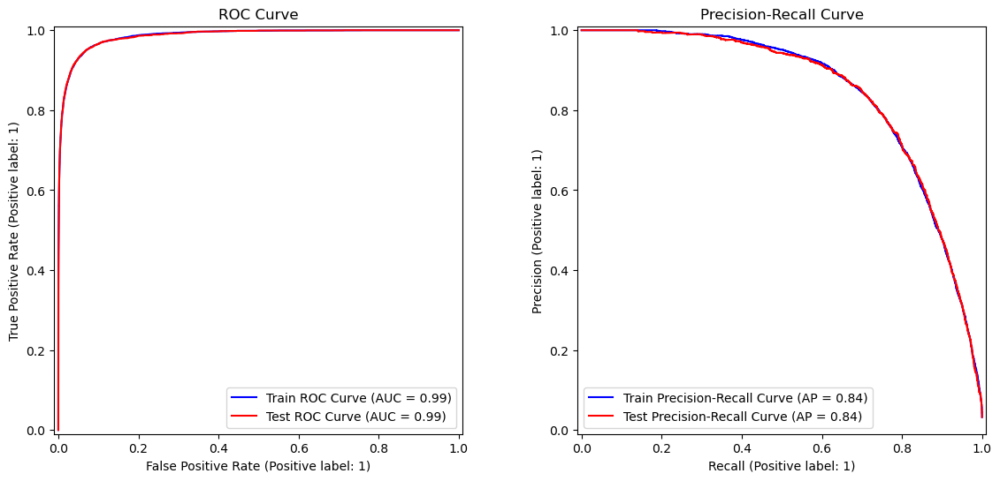

In [57]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_svm, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    gridsearch_svm, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_svm, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    gridsearch_svm, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

### 8. Stacking

In [58]:
# Stacking
print('Training stacking regressor...')
stacking = StackingClassifier(estimators = [
        ("basemodel", basemodel),
        ("logreg", reglogmul_model),
        ("tree", gridsearch_tree.best_estimator_), 
        ("svm", gridsearch_svm.best_estimator_), 
        ("regressor_ada", gridsearch_ada.best_estimator_),
        ("forest", gridsearch_rf.best_estimator_), 
        ("xgb_cls", gridsearch_xgb.best_estimator_),
    ], 
    cv=5,
    n_jobs=n_jobs
)

preds = stacking.fit_transform(X_train, y_train)
predictions = pd.DataFrame(preds, columns=stacking.named_estimators_.keys())
print('...Done.')

y_train_pred = stacking.predict(X_train)
y_test_pred = stacking.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['stacking1'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

display(predictions)

Training stacking regressor...
...Done.
Écart type des résidus sur y_train : 0.1171803327254607
Écart type des résidus sur y_test : 0.11695181038076424
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    192780
           1       0.85      0.69      0.76      6426

    accuracy                           0.99    199206
   macro avg       0.92      0.84      0.88    199206
weighted avg       0.99      0.99      0.99    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     82620
           1       0.86      0.69      0.76      2754

    accuracy                           0.99     85374
   macro avg       0.92      0.84      0.88     85374
weighted avg       0.99      0.99      0.99     85374



,basemodel,logreg,tree,svm,regressor_ada,forest,xgb_cls
0,0.000867,0.000867,0.000253,-3.707705,0.119203,0.000368,0.000603
1,0.089672,0.089672,0.063187,-1.274299,0.119203,0.013290,0.081021
2,0.000019,0.000019,0.000253,-5.746797,0.119203,0.000043,0.000288
3,0.000317,0.000317,0.000253,-4.255689,0.119203,0.000000,0.000350
4,0.000002,0.000002,0.000253,-6.885403,0.119203,0.000000,0.000157
...,...,...,...,...,...,...,...
199201,0.038263,0.038263,0.024749,-1.706842,0.119203,0.001481,0.029852
199202,0.001355,0.001355,0.002342,-3.511379,0.119203,0.006291,0.001825
199203,0.000303,0.000303,0.004541,-4.335304,0.119203,0.000000,0.000675
199204,0.004116,0.004116,0.002342,-2.883130,0.119203,0.012692,0.003511


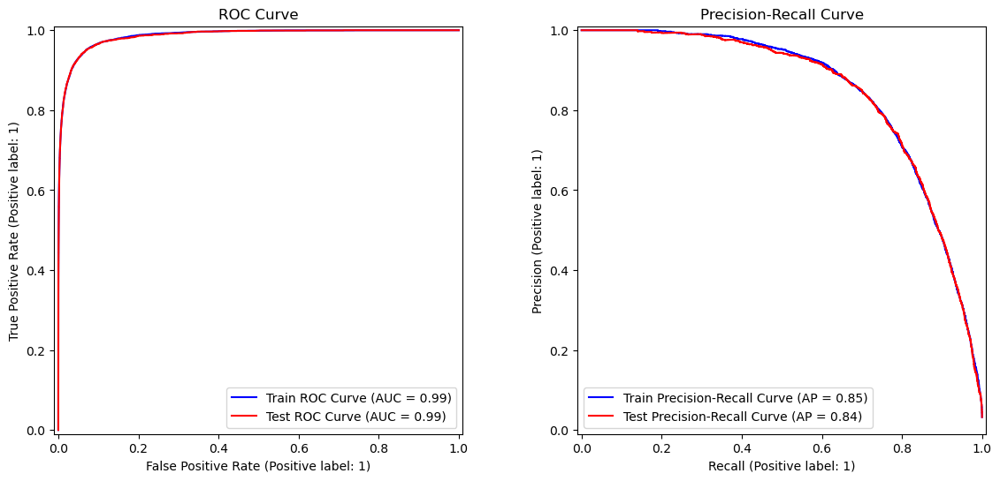

In [59]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    stacking, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    stacking, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    stacking, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    stacking, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

In [60]:
# Check the predictions are independent
# Correlation matrix
corr_matrix = predictions.corr().round(2)
fig = ff.create_annotated_heatmap(corr_matrix.values,
    x = corr_matrix.columns.tolist(),
    y = corr_matrix.index.tolist(),
    colorscale='Viridis',
    showscale=True,
    zmin=-1,
    zmax=1
)
fig.update_layout(
    width=800,
    height=600,
    margin=dict(t=50, r=50, l=50, b=50) 
)
                                  
fig.show()

### 9. Stacking tuned

In [61]:
# Suppression des modèles corrélés
print('Training stacking_tune regressor...')
stacking_tune = StackingClassifier(estimators = [
        ("tree_clf", gridsearch_tree.best_estimator_), 
        ("svm_clf", gridsearch_svm.best_estimator_), 
        ("xgb_cls", gridsearch_xgb.best_estimator_), 
    ],
    final_estimator=gridsearch_ada.best_estimator_, 
    cv=5
)

preds = stacking_tune.fit_transform(X_train, y_train)
predictions = pd.DataFrame(preds, columns=stacking_tune.named_estimators_.keys())
print('...Done.')

y_train_pred = stacking_tune.predict(X_train)
y_test_pred = stacking_tune.predict(X_test)

# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

# Calculate standard deviation of residuals
train_std_dev = np.std(train_residuals)
test_std_dev = np.std(test_residuals)

print(f"Écart type des résidus sur y_train : {train_std_dev}")
print(f"Écart type des résidus sur y_test : {test_std_dev}")

tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred, labels=[0, 1]).ravel()

score_save['stacking_tune'] = {
    'f1_train': f1_score(y_train, y_train_pred),
    'f1_test': f1_score(y_test, y_test_pred),
    'recall_train': recall_score(y_train, y_train_pred),
    'recall_test': recall_score(y_test, y_test_pred),
    'precision_train': precision_score(y_train, y_train_pred),
    'precision_test': precision_score(y_test, y_test_pred),
    'fp': fp,
    'fn': fn,
    'train_std_dev': train_std_dev,
    'test_std_dev': test_std_dev
}

print("Classification report on train set:")
print(classification_report(y_train, y_train_pred))
print()
print("Classification report on test set:")
print(classification_report(y_test, y_test_pred))

display(predictions)

%time

Training stacking_tune regressor...
...Done.
Écart type des résidus sur y_train : 0.12367397079186078
Écart type des résidus sur y_test : 0.12382294542226728
Classification report on train set:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99    192780
           1       0.76      0.77      0.77      6426

    accuracy                           0.98    199206
   macro avg       0.87      0.88      0.88    199206
weighted avg       0.98      0.98      0.98    199206


Classification report on test set:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     82620
           1       0.76      0.77      0.76      2754

    accuracy                           0.98     85374
   macro avg       0.87      0.88      0.88     85374
weighted avg       0.98      0.98      0.98     85374



,tree_clf,svm_clf,xgb_cls
0,0.000253,-3.707705,0.000603
1,0.063187,-1.274299,0.081021
2,0.000253,-5.746797,0.000288
3,0.000253,-4.255689,0.000350
4,0.000253,-6.885403,0.000157
...,...,...,...
199201,0.024749,-1.706842,0.029852
199202,0.002342,-3.511379,0.001825
199203,0.004541,-4.335304,0.000675
199204,0.002342,-2.883130,0.003511


CPU times: user 3 μs, sys: 0 ns, total: 3 μs
Wall time: 7.15 μs


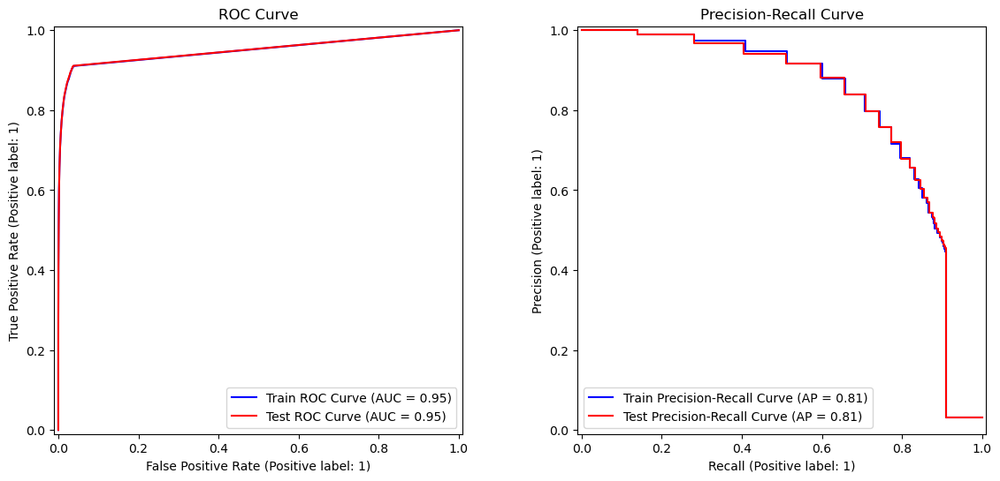

In [62]:
# Créer deux sous-graphes ROC et Recall côte à côte
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Tracer la courbe ROC sur le premier sous-graphe
roc_display = RocCurveDisplay.from_estimator(
    stacking_tune, X_train, y_train, ax=ax1, color='blue', name='Train ROC Curve'
)
roc_display = RocCurveDisplay.from_estimator(
    stacking_tune, X_test, y_test, ax=ax1, color='red', name='Test ROC Curve'
)
ax1.set_title('ROC Curve')

# Tracer la courbe Precision-Recall sur le deuxième sous-graphe
pr_display = PrecisionRecallDisplay.from_estimator(
    stacking_tune, X_train, y_train, ax=ax2, color='blue', name='Train Precision-Recall Curve'
)
pr_display = PrecisionRecallDisplay.from_estimator(
    stacking_tune, X_test, y_test, ax=ax2, color='red', name='Test Precision-Recall Curve'
)
ax2.set_title('Precision-Recall Curve')

# Afficher la figure
plt.show()

In [63]:
# Check the predictions are independent
# Correlation matrix
corr_matrix = predictions.corr().round(2)
fig = ff.create_annotated_heatmap(corr_matrix.values,
    x = corr_matrix.columns.tolist(),
    y = corr_matrix.index.tolist(),
    colorscale='Viridis',
    showscale=True,
    zmin=-1,
    zmax=1
)
fig.update_layout(
    width=800,
    height=600,
    margin=dict(t=50, r=50, l=50, b=50) 
)
                                  
fig.show()

In [64]:
scores_df = pd.DataFrame(score_save).transpose()
display(scores_df)

,f1_train,f1_test,recall_train,recall_test,precision_train,precision_test,fp,fn,train_std_dev,test_std_dev
basemodel,0.691893,0.702635,0.598973,0.610022,0.818936,0.828402,348.0,1074.0,0.130894,0.128778
reglogmul_model,0.762840,0.764860,0.688764,0.689179,0.854770,0.859212,311.0,856.0,0.117369,0.116741
tree_clf,0.741606,0.743761,0.661687,0.665577,0.843483,0.842759,342.0,921.0,0.121761,0.121440
forest_clf,0.780655,0.753948,0.710862,0.684822,0.865643,0.838595,363.0,868.0,0.113371,0.119933
ada_cls,0.741948,0.743519,0.736695,0.734205,0.747277,0.753073,663.0,732.0,0.128571,0.127825
xgb_cls,0.767072,0.766944,0.701836,0.702614,0.845678,0.844241,357.0,819.0,0.117130,0.117241
svm_cls,0.759606,0.756735,0.678338,0.673203,0.862997,0.863933,292.0,900.0,0.117483,0.117947
stacking1,0.763881,0.764812,0.690476,0.691358,0.854749,0.855730,321.0,850.0,0.117180,0.116952
stacking_tune,0.765417,0.764695,0.773576,0.772331,0.757428,0.757209,682.0,627.0,0.123674,0.123823


In [65]:
# Scores pour le train
sorted_scores = scores_df['f1_train'].sort_values(ascending=False)
fig = px.bar(
    x=sorted_scores.index,
    y=sorted_scores.values,
    color=sorted_scores.values,
    labels={'x': 'Model', 'y': 'F1 Score'},
    title='Sorted models F1-Scores for train',
    color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(
    xaxis_title='Model',
    yaxis_title='F1 Score'
)

# Définir les limites de l'axe des ordonnées (y) entre 0 et 1
fig.update_yaxes(range=[0, 1])

fig.show()

In [66]:
# Scores pour le test
sorted_scores = scores_df['f1_test'].sort_values(ascending=False)
fig = px.bar(
    x=sorted_scores.index,
    y=sorted_scores.values,
    color=sorted_scores.values,
    labels={'x': 'Model', 'y': 'F1 Score'},
    title='Sorted models F1-Scores for test',
    color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(
    xaxis_title='Model',
    yaxis_title='F1 Score'
)

# Définir les limites de l'axe des ordonnées (y) entre 0 et 1
fig.update_yaxes(range=[0, 1])

fig.show()

## 5. Conclusion

In [67]:
# Résultats 
# @todo virer le std, n a pas d interet
print("Meilleurs résultats en fonction du score f1 sur le test :") 
print()

scores_df = scores_df.reset_index().rename(columns={'index': 'model'})
scores_df.rename(columns={'index': 'model'}, inplace=True)

display(scores_df.sort_values(by='f1_test', ascending=False))

Meilleurs résultats en fonction du score f1 sur le test :



,model,f1_train,f1_test,recall_train,recall_test,precision_train,precision_test,fp,fn,train_std_dev,test_std_dev
5,xgb_cls,0.767072,0.766944,0.701836,0.702614,0.845678,0.844241,357.0,819.0,0.117130,0.117241
1,reglogmul_model,0.762840,0.764860,0.688764,0.689179,0.854770,0.859212,311.0,856.0,0.117369,0.116741
7,stacking1,0.763881,0.764812,0.690476,0.691358,0.854749,0.855730,321.0,850.0,0.117180,0.116952
8,stacking_tune,0.765417,0.764695,0.773576,0.772331,0.757428,0.757209,682.0,627.0,0.123674,0.123823
6,svm_cls,0.759606,0.756735,0.678338,0.673203,0.862997,0.863933,292.0,900.0,0.117483,0.117947
3,forest_clf,0.780655,0.753948,0.710862,0.684822,0.865643,0.838595,363.0,868.0,0.113371,0.119933
2,tree_clf,0.741606,0.743761,0.661687,0.665577,0.843483,0.842759,342.0,921.0,0.121761,0.121440
4,ada_cls,0.741948,0.743519,0.736695,0.734205,0.747277,0.753073,663.0,732.0,0.128571,0.127825
0,basemodel,0.691893,0.702635,0.598973,0.610022,0.818936,0.828402,348.0,1074.0,0.130894,0.128778


In [68]:
# Création du graphique en barres groupées
fig = px.bar(scores_df, x='model', y=['f1_train', 'f1_test', 'recall_train', 'recall_test'],
             title="Comparaison des Métriques de Performance des Modèles",
             labels={'value': 'Score', 'variable': 'Métrique'},
             barmode='group')

fig.update_layout(
    xaxis_title='Modèle',
    yaxis_title='Score',
    xaxis_tickangle=-45,
    legend_title='Métrique',
    legend=dict(x=1, y=1),
    height=600
)

fig.show()

Avec un modèle très déséquilibré, où les prédictions de la classe "0" représentent environ 3% des données, il est important de choisir les bons indicateurs de performance en fonction de nos objectifs spécifiques.

Si notre objectif principal est de minimiser les erreurs de prédiction, tant pour les cas où nous prédisons qu'un visiteur s'inscrira à la newsletter (classe "1") que pour les cas où nous prédisons qu'il ne s'inscrira pas (classe "0"), le F1-score est un indicateur particulièrement adapté. Contrairement à la précision (accuracy), qui ne prend en compte que le ratio global des bonnes réponses par rapport aux mauvaises, le F1-score calcule la moyenne harmonique de la précision et du rappel (recall). Cela permet de mieux évaluer la performance d'un modèle dans un contexte de classes très déséquilibrées.

Cependant, si notre priorité est de ne pas manquer de potentiels inscrits à la newsletter — par exemple, pour les cibler avec un envoi de mails — et que l'envoi de mails à des visiteurs non intéressés est moins problématique, nous devrions privilégier un modèle avec un rappel élevé. Le rappel mesure la proportion de vrais positifs détectés par rapport à l'ensemble des véritables positifs, donc un modèle avec un bon rappel minimisera les faux négatifs, c'est-à-dire les inscrits potentiels qui ne seront pas identifiés.
Comparaison entre Modèles :

**Performance Générale :** Les modèles xgb_cls, stacking et reglogmul_model semblent être les meilleurs en termes de score F1 sur l'ensemble de test. stacking_tune est 2em dans le classement mais possède un score de recall les plus intéressant. 

AdaBoost (ada_cls): Ce modèle semble être moins performant, avec des scores F1 plus bas sur les ensembles d'entraînement et de test. Cependant, AdaBoost présente un bon score de rappel tout comme stacking_tune, ce qui peut être avantageux pour minimiser la perte de potentiels inscrits, minimiser les faux négatifs.

**Pistes d'Amélioration :**

- Optimisation des Hyperparamètres : Ajuster les hyperparamètres des modèles pour améliorer leurs performances.

- Combinaison de Modèles : Continuer à explorer différentes combinaisons de modèles ensemblistes pour tirer parti des forces de chacun.

- Augmentation des Données : Enrichir le jeu de données pour améliorer la robustesse du modèle.

- Analyse des Importances des Variables : Examiner quelles caractéristiques sont les plus influentes pour la prédiction afin de mieux comprendre le modèle et d'optimiser ses performances.


@todo ajouter une conclusion pour la partie métier

## 6. Faire la prédiction et enregistrer le résultat

Mon choix va se faire entre XGB et Stacking_tune. Tout dépend ce que je minimiser.
Si je vais minimiser les faux négatifs, ce qui me semble être le plus judicieux, j'irais sur le modèle stacking_tune, quite à avoir plus de faux positifs.
Si je recherche quelquechose de plus équilibré ou de plus rapide, j'irais sur XGB. 

In [77]:
# Concatenate our train and test set to train your best classifier on all data with labels
X = np.append(X_train,X_test,axis=0)
Y = np.append(y_train,y_test)

# Train model
print("Train model...")
gridsearch_xgb.fit(X, Y)
print("...Done.")

# Predictions on all set
print("Predictions on X...")
y_pred = stacking_tune.predict(X)
print("...Done.")
print(y_pred)
print()

# Make predictions and dump to file
data = {
    'converted': y_pred,
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('output/conversion_data_test_predictions_alex-stacking_tune.csv', index=False)


Train model...
...Done.
Predictions on X...
...Done.
[0 0 0 ... 0 0 0]



In [78]:
data_saved = pd.read_csv('output/conversion_data_test_predictions_alex-stacking_tune.csv')
display(data_saved)
display(data_saved['converted'].value_counts())

,converted
0,0
1,0
2,0
3,0
4,0
...,...
284575,0
284576,0
284577,0
284578,0


converted
0    275208
1      9372
Name: count, dtype: int64